# PHASE III: Construction of the model

Citations for each dataset lie above where each set was added to the master_data dataframe. The module dill was used to preserve kernel as the model is passed to phase III, note this is also since the computer it was worked on could not install the module imblearn successfully so the kernel was passed from the high performace cluster provided by Tufts where imblearn was installed.

In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import tree
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score, train_test_split
%matplotlib inline

## Assembly of the dataset:

This data includes both bots and humans from 2019. 

Mazza, Michele, Stefano Cresci, Marco Avvenuti, Walter Quattrociocchi, and Maurizio Tesconi. "RTbust: Exploiting Temporal Patterns for Botnet Detection on Twitter." arXiv preprint arXiv:1902.04506 (2019).

In [3]:
data_from_json = pd.read_json('data/cresci-rtbust-2019_tweets.json')

all_users = pd.DataFrame()
users = data_from_json['user']
for user in users:
    all_users = pd.concat([all_users, pd.DataFrame(user)])

all_users = all_users.reset_index()[['id', 
                                     'name', 
                                     'location', 
                                     'description', 
                                     'protected', 
                                     'followers_count',
                                     'friends_count',
                                     'favourites_count',
                                     'listed_count',
                                     'statuses_count',
                                     'verified',
                                     'geo_enabled',
                                     'contributors_enabled',
                                     'is_translator',
                                     'is_translation_enabled',
                                     'default_profile',
                                     'default_profile_image']]

all_users = all_users.drop_duplicates()
data_from_tsv = pd.read_csv('data/cresci-rtbust-2019.tsv', sep = '\t')
master_data = pd.merge(all_users, data_from_tsv, on = 'id')

These datasets contain only human users

the first is from : Yang, Kai-Cheng, Onur Varol, Pik-Mai Hui, and Filippo Menczer "Scalable and Generalizable Social Bot Detection through Data Selection." AAAI2020, arXiv preprint arXiv:1911.09179 (2019).


the second is from : Yang, Kai‐Cheng, Onur Varol, Clayton A. Davis, Emilio Ferrara, Alessandro Flammini, and Filippo Menczer. "Arming the public with artificial intelligence to counter social bots." Human Behavior and Emerging Technologies 1, no. 1 (2019): 48-61.

In [4]:
humans_from_json = pd.read_json('data/verified-2019_tweets.json')
all_humans = pd.DataFrame()
users = humans_from_json['user']
for user in users:
    all_humans = pd.concat([all_humans, pd.DataFrame(user)])

all_humans = all_humans.reset_index()[['id', 
                                     'name', 
                                     'location', 
                                     'description', 
                                     'protected', 
                                     'followers_count',
                                     'friends_count',
                                     'favourites_count',
                                     'listed_count',
                                     'statuses_count',
                                     'verified',
                                     'geo_enabled',
                                     'contributors_enabled',
                                     'is_translator',
                                     'is_translation_enabled',
                                     'default_profile',
                                     'default_profile_image']]
all_humans = all_humans.drop_duplicates()
all_humans['class'] = 'human'
master_data = pd.concat([master_data, all_humans])

In [5]:
more_humans_from_json = pd.read_json('data/celebrity-2019_tweets.json')
all_humans = pd.DataFrame()
users = pd.DataFrame(list(more_humans_from_json['user']))

all_humans = users.reset_index()[['default_profile_image',
                                     'id', 
                                     'name', 
                                     'location', 
                                     'description', 
                                     'protected', 
                                     'followers_count',
                                     'friends_count',
                                     'favourites_count',
                                     'listed_count',
                                     'statuses_count',
                                     'verified',
                                     'geo_enabled',
                                     'contributors_enabled',
                                     'is_translator',
                                     'is_translation_enabled',
                                     'default_profile']]
all_humans = all_humans.drop_duplicates()
all_humans['class'] = 'human'
master_data = pd.concat([master_data, all_humans])

# BOTS

These datasets contain only "bot" users

the first is from : Yang, Kai-Cheng, Onur Varol, Pik-Mai Hui, and Filippo Menczer "Scalable and Generalizable Social Bot Detection through Data Selection." AAAI2020, arXiv preprint arXiv:1911.09179 (2019).

the second is from : Yang, Kai‐Cheng, Onur Varol, Clayton A. Davis, Emilio Ferrara, Alessandro Flammini, and Filippo Menczer. "Arming the public with artificial intelligence to counter social bots." Human Behavior and Emerging Technologies 1, no. 1 (2019): 48-61.

In [6]:
bots_from_json = pd.read_json('data/botwiki-2019_tweets.json')
all_bots = pd.DataFrame()
users = bots_from_json['user']
for user in users:
    all_bots = pd.concat([all_bots, pd.DataFrame(user)])
    
all_bots = all_bots.reset_index()[['id', 
                                     'name', 
                                     'location', 
                                     'description', 
                                     'protected', 
                                     'followers_count',
                                     'friends_count',
                                     'favourites_count',
                                     'listed_count',
                                     'statuses_count',
                                     'verified',
                                     'geo_enabled',
                                     'contributors_enabled',
                                     'is_translator',
                                     'is_translation_enabled',
                                     'default_profile',
                                     'default_profile_image']]

all_bots = all_bots.drop_duplicates()
all_bots['class'] = 'bot'
master_data = pd.concat([master_data, all_bots])

In [7]:
additional_data_from_json = pd.read_json('data/vendor-purchased-2019_tweets.json')
all_users = pd.DataFrame()
users = additional_data_from_json['user']
for user in users:
    all_users = pd.concat([all_users, pd.DataFrame(user)])

all_users = all_users.reset_index()[['id', 
                                     'name', 
                                     'location', 
                                     'description', 
                                     'protected', 
                                     'followers_count',
                                     'friends_count',
                                     'favourites_count',
                                     'listed_count',
                                     'statuses_count',
                                     'verified',
                                     'geo_enabled',
                                     'contributors_enabled',
                                     'is_translator',
                                     'is_translation_enabled',
                                     'default_profile',
                                     'default_profile_image']]


all_users = all_users.drop_duplicates()
data_from_tsv = pd.read_csv('data/vendor-purchased-2019.tsv', sep = '\t')
data_from_tsv.columns = ['id', 'class']
master_data = pd.concat([master_data, pd.merge(all_users, data_from_tsv, on = 'id')])

## Assembly of training set, feature selection based on any features that come from twitter query of a user that could be used and ones that actually differ from user to user

In [11]:
count = 0
for user in list(y_train['class']):
    if user == 'bot':
        count+=1
print(count / len(y_train), "= bot percentage")




0.08483568305742496 = bot percentage


In [30]:
features = master_data[['protected',
                       'followers_count',
                       'friends_count',
                       'favourites_count',
                       'listed_count',
                       'statuses_count',
                       'verified',
                       'geo_enabled',
                       'contributors_enabled',
                       'is_translator',
                       'is_translation_enabled',
                       'default_profile',
                       'default_profile_image']]
target = master_data['class']
temp1 = features['friends_count'].replace(to_replace = 0, value = .00001)
temp2 = features['favourites_count'].replace(to_replace = 0, value = .00001)
features['ratio'] = [follow_num / friend_num for (follow_num, friend_num) in zip(features['followers_count'], temp1)]
features['status ratio'] = [status_num / favourite_num for (status_num, favourite_num) in zip(features['statuses_count'], temp2)]

/Users/alexseto/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/alexseto/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [31]:
target = target.reset_index().drop(["index"], axis = 1)
features = features.reset_index().drop(["index"], axis = 1)
len(master_data['id'].unique())


25362

In [32]:
target = pd.DataFrame(target)

# USE OF SMOTE TO RESAMPLE:

In [36]:
# split test set
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size = .2)


#import imblearn

#os = imblearn.over_sampling.SMOTE(sampling_strategy = .15, random_state = 4)
#os_data_X,os_data_y = os.fit_resample(X_train, y_train)

"""
import dill
dill.dump_session('last_one.db')
"""

"\nimport dill\ndill.dump_session('last_one.db')\n"

In [1]:
import dill
dill.load_session('last_one.db')

## Construction of the SMOTE model:

In [12]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

rf_tree = RandomForestClassifier().fit(os_data_X, os_data_y)


param_dist = {'n_estimators': randint(10, 100),
              'max_leaf_nodes': randint(3, 300),
              'max_features': ["auto"],
              'max_depth': randint(1, 10),
              'min_samples_leaf': randint(1, 30),
              'min_samples_split': randint(2, 20)}
rnd_search = RandomizedSearchCV(rf_tree, param_distributions = param_dist, cv = 10, n_iter = 100).fit(os_data_X, np.array(os_data_y).ravel())


rf_tree.set_params(n_estimators = rnd_search.best_params_['n_estimators'], 
                   max_leaf_nodes = rnd_search.best_params_['max_leaf_nodes'],                  
                   max_features = rnd_search.best_params_['max_features'],
                   max_depth = rnd_search.best_params_['max_depth'],
                   min_samples_leaf = rnd_search.best_params_['min_samples_leaf'],
                   min_samples_split = rnd_search.best_params_['min_samples_split'])

rf_tree.fit(os_data_X, np.array(os_data_y).ravel())

KeyboardInterrupt: 

In [3]:
rf_train_score = rf_tree.score(os_data_X, np.array(os_data_y).ravel())

rf_tree.fit(os_data_X, np.array(os_data_y).ravel())
y_pred = rf_tree.predict(X_test)

from sklearn.metrics import classification_report, confusion_matrix  

print('CONFUSION MATRIX:')
print(confusion_matrix(y_test, y_pred)) 
print('\nCLASSIFICATION REPORT')
print(classification_report(y_test, y_pred)) 

print('Train Score: ', rf_train_score)
print('Test Score: ', rf_tree.score(X_test, y_test))

CONFUSION MATRIX:
[[ 317   93]
 [  57 4623]]

CLASSIFICATION REPORT
              precision    recall  f1-score   support

         bot       0.85      0.77      0.81       410
       human       0.98      0.99      0.98      4680

    accuracy                           0.97      5090
   macro avg       0.91      0.88      0.90      5090
weighted avg       0.97      0.97      0.97      5090

Train Score:  0.9734876773711725
Test Score:  0.9705304518664047


In [4]:
rnd_search.best_params_


{'max_depth': 9,
 'max_features': 'auto',
 'max_leaf_nodes': 234,
 'min_samples_leaf': 9,
 'min_samples_split': 10,
 'n_estimators': 82}

Feature ranking:
0. followers_count (0.376317)
1. listed_count (0.171224)
2. ratio (0.153428)
3. friends_count (0.072432)
4. default_profile (0.052917)
5. statuses_count (0.045750)
6. verified (0.037544)
7. status ratio (0.027462)
8. geo_enabled (0.026410)
9. favourites_count (0.022797)
10. default_profile_image (0.013625)
11. is_translation_enabled (0.000095)
12. is_translator (0.000000)
13. contributors_enabled (0.000000)
14. protected (0.000000)


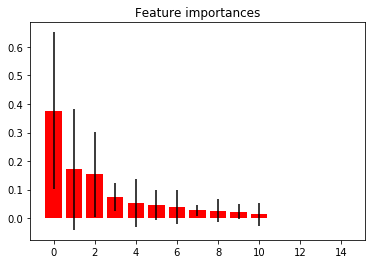

In [5]:
importances = rf_tree.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf_tree.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

print("Feature ranking:")

for f in range(X_train.shape[1]):
    print("%d. %s (%f)" % (f, X_train.columns[indices[f]], importances[indices[f]]))
    
plt.figure()
plt.title("Feature importances")
plt.bar(range(X_train.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.show()

In [8]:
from sklearn.tree import export_graphviz
estimator = rf_tree.estimators_[5]
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = X_train.columns,
                class_names = ['human', 'bot'],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

## MODEL BUILT WITHOUT SMOTE

Note, the model was stored on the pickled kernel below.

In [6]:
import dill
dill.load_session('data/no_smote.db')

In [9]:
y_pred = rf_tree.predict(X_test)

from sklearn.metrics import classification_report, confusion_matrix  

print('CONFUSION MATRIX:')
print(confusion_matrix(y_test, y_pred)) 
print('\nCLASSIFICATION REPORT')
print(classification_report(y_test, y_pred)) 

print('Train Score: ', rf_train_score)
print('Test Score: ', rf_tree.score(X_test, y_test))

CONFUSION MATRIX:
[[ 288  122]
 [  29 4651]]

CLASSIFICATION REPORT
              precision    recall  f1-score   support

         bot       0.91      0.70      0.79       410
       human       0.97      0.99      0.98      4680

    accuracy                           0.97      5090
   macro avg       0.94      0.85      0.89      5090
weighted avg       0.97      0.97      0.97      5090

Train Score:  0.9769121186815346
Test Score:  0.9703339882121808


Feature ranking:
0. followers_count (0.358352)
1. listed_count (0.207207)
2. ratio (0.141399)
3. friends_count (0.071969)
4. statuses_count (0.057783)
5. default_profile (0.043120)
6. verified (0.042691)
7. status ratio (0.027645)
8. favourites_count (0.022360)
9. default_profile_image (0.015988)
10. geo_enabled (0.011210)
11. is_translation_enabled (0.000278)
12. is_translator (0.000000)
13. contributors_enabled (0.000000)
14. protected (0.000000)


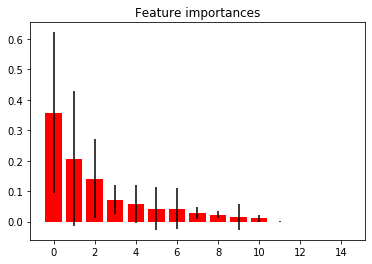

In [10]:
importances = rf_tree.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf_tree.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

print("Feature ranking:")

for f in range(X_train.shape[1]):
    print("%d. %s (%f)" % (f, X_train.columns[indices[f]], importances[indices[f]]))
    
plt.figure()
plt.title("Feature importances")
plt.bar(range(X_train.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.show()

In [7]:
from sklearn.tree import export_graphviz
estimator = rf_tree.estimators_[5]
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = X_train.columns,
                class_names = ['human', 'bot'],
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')